# Importing Required Libraries

In [1]:
# Importing some basic libraries like for dealing with arrays and data manipulation, date manipulation
import numpy as np
import pandas as pd 
from datetime import datetime
import dateutil.parser
import re
from tqdm.notebook import tqdm
# Importing some Visualization libraries
import plotly.express as px
import plotly.io as pio
import plotly.graph_objects as go
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
import seaborn as sns 
from IPython.display import IFrame
from wordcloud import WordCloud, ImageColorGenerator
import matplotlib.pyplot as plt
import random 
# Installing required packages 
! pip install pyspellchecker
! pip install scattertext
! pip install nltk
! pip install -U kaleido
! pip install twython
# Importing sentiment based libraries
import nltk
import scattertext as st
from spellchecker import SpellChecker
from nltk.sentiment.vader import SentimentIntensityAnalyzer as SIA
from nltk.corpus import stopwords

# Downloading periphrals from nltk
nltk.download('vader_lexicon')
nltk.download('stopwords')

import warnings
warnings.filterwarnings('ignore')
pd.set_option("display.max_columns",None)   # setting for showing max columns

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.8/6.8 MB 50.0 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 18.1 MB/s eta 0:00:00:00:0100:01
[nltk_data] Downloading package vader_lexicon to
[nltk_data]     /usr/share/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!
[nltk_data] Downloading package stopwords to /usr/share/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


# Loading Tweets Data

In [2]:
# reading data from the csv file
tweets_data = pd.read_csv('/kaggle/input/apple-twitter-sentiment-crowdflower/Apple-Twitter-Sentiment-DFE.csv', encoding='cp1252')    

In [3]:
# visualizing the first five rows of data
tweets_data.head()

,_unit_id,_golden,_unit_state,_trusted_judgments,_last_judgment_at,sentiment,sentiment:confidence,date,id,query,sentiment_gold,text
0,623495513,True,golden,10,NaN,3,0.6264,Mon Dec 01 19:30:03 +0000 2014,5.400000e+17,#AAPL OR @Apple,3\nnot_relevant,#AAPL:The 10 best Steve Jobs emails ever...htt...
1,623495514,True,golden,12,NaN,3,0.8129,Mon Dec 01 19:43:51 +0000 2014,5.400000e+17,#AAPL OR @Apple,3\n1,RT @JPDesloges: Why AAPL Stock Had a Mini-Flas...
2,623495515,True,golden,10,NaN,3,1.0000,Mon Dec 01 19:50:28 +0000 2014,5.400000e+17,#AAPL OR @Apple,3,My cat only chews @apple cords. Such an #Apple...
3,623495516,True,golden,17,NaN,3,0.5848,Mon Dec 01 20:26:34 +0000 2014,5.400000e+17,#AAPL OR @Apple,3\n1,I agree with @jimcramer that the #IndividualIn...
4,623495517,False,finalized,3,12/12/14 12:14,3,0.6474,Mon Dec 01 20:29:33 +0000 2014,5.400000e+17,#AAPL OR @Apple,NaN,Nobody expects the Spanish Inquisition #AAPL


In [4]:
# Checking the number of rows and columns in the data
tweets_data.shape

(3886, 12)

In [5]:
# Getting data type about columns in the data
tweets_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3886 entries, 0 to 3885
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   _unit_id              3886 non-null   int64  
 1   _golden               3886 non-null   bool   
 2   _unit_state           3886 non-null   object 
 3   _trusted_judgments    3886 non-null   int64  
 4   _last_judgment_at     3783 non-null   object 
 5   sentiment             3886 non-null   object 
 6   sentiment:confidence  3886 non-null   float64
 7   date                  3886 non-null   object 
 8   id                    3886 non-null   float64
 9   query                 3886 non-null   object 
 10  sentiment_gold        103 non-null    object 
 11  text                  3886 non-null   object 
dtypes: bool(1), float64(2), int64(2), object(7)
memory usage: 337.9+ KB


In [6]:
# Extracting statistical description of data and its columns
tweets_data.describe(include = 'all')

,_unit_id,_golden,_unit_state,_trusted_judgments,_last_judgment_at,sentiment,sentiment:confidence,date,id,query,sentiment_gold,text
count,3.886000e+03,3886,3886,3886.000000,3783,3886,3886.000000,3886,3.886000e+03,3886,103,3886
unique,NaN,2,2,NaN,388,4,NaN,3795,NaN,1,9,3219
top,NaN,False,finalized,NaN,12/12/14 2:56,3,NaN,Thu Dec 04 20:39:58 +0000 2014,NaN,#AAPL OR @Apple,1,"RT @OneRepublic: Studio at 45,000 ft. One out..."
freq,NaN,3783,3782,NaN,33,2162,NaN,5,NaN,3886,39,304
mean,6.234975e+08,NaN,NaN,3.687082,NaN,NaN,0.829526,NaN,5.410039e+17,NaN,NaN,NaN
std,1.171906e+03,NaN,NaN,2.004595,NaN,NaN,0.175864,NaN,7.942752e+14,NaN,NaN,NaN
min,6.234955e+08,NaN,NaN,3.000000,NaN,NaN,0.332700,NaN,5.400000e+17,NaN,NaN,NaN
25%,6.234965e+08,NaN,NaN,3.000000,NaN,NaN,0.674475,NaN,5.400000e+17,NaN,NaN,NaN
50%,6.234975e+08,NaN,NaN,3.000000,NaN,NaN,0.811250,NaN,5.410000e+17,NaN,NaN,NaN
75%,6.234984e+08,NaN,NaN,3.000000,NaN,NaN,1.000000,NaN,5.420000e+17,NaN,NaN,NaN


# Data Preprocessing

In [7]:
# Checking for null values in the data
null_counts = tweets_data.isnull().sum()
print("Null values in each column:")
print(null_counts)

# Checking for duplicate rows in the data
duplicate_counts = tweets_data.duplicated().sum()
print(f"Number of duplicate rows: {duplicate_counts}")

# Dropping duplicate rows
tweets_data = tweets_data.drop_duplicates()

Null values in each column:
_unit_id                   0
_golden                    0
_unit_state                0
_trusted_judgments         0
_last_judgment_at        103
sentiment                  0
sentiment:confidence       0
date                       0
id                         0
query                      0
sentiment_gold          3783
text                       0
dtype: int64
Number of duplicate rows: 0


In [8]:
# Extracting only relevant columns from the data
tweets_data = tweets_data[['date', 'text']]
# visualizing the data after extracting relevant columns
tweets_data.head()

,date,text
0,Mon Dec 01 19:30:03 +0000 2014,#AAPL:The 10 best Steve Jobs emails ever...htt...
1,Mon Dec 01 19:43:51 +0000 2014,RT @JPDesloges: Why AAPL Stock Had a Mini-Flas...
2,Mon Dec 01 19:50:28 +0000 2014,My cat only chews @apple cords. Such an #Apple...
3,Mon Dec 01 20:26:34 +0000 2014,I agree with @jimcramer that the #IndividualIn...
4,Mon Dec 01 20:29:33 +0000 2014,Nobody expects the Spanish Inquisition #AAPL


In [9]:
# Converting date to datetime format
tweets_data['date'] = pd.to_datetime(tweets_data['date'], format='%a %b %d %H:%M:%S %z %Y')

# Converting date to a more readable string format
tweets_data['date'] = tweets_data['date'].dt.strftime('%Y-%m-%d %H:%M:%S')

# visualizing the data after changing the date column
tweets_data.head()

,date,text
0,2014-12-01 19:30:03,#AAPL:The 10 best Steve Jobs emails ever...htt...
1,2014-12-01 19:43:51,RT @JPDesloges: Why AAPL Stock Had a Mini-Flas...
2,2014-12-01 19:50:28,My cat only chews @apple cords. Such an #Apple...
3,2014-12-01 20:26:34,I agree with @jimcramer that the #IndividualIn...
4,2014-12-01 20:29:33,Nobody expects the Spanish Inquisition #AAPL


In [10]:
# Extracting the year, month, day, hour, minute from the date column
tweets_data['date'] = pd.to_datetime(tweets_data['date'])
tweets_data['year'] = tweets_data['date'].dt.year
tweets_data['month'] = tweets_data['date'].dt.month
tweets_data['day'] = tweets_data['date'].dt.day
tweets_data['hour'] = tweets_data['date'].dt.hour
tweets_data['minute'] = tweets_data['date'].dt.minute
tweets_data.head()                # data after required transformations

,date,text,year,month,day,hour,minute
0,2014-12-01 19:30:03,#AAPL:The 10 best Steve Jobs emails ever...htt...,2014,12,1,19,30
1,2014-12-01 19:43:51,RT @JPDesloges: Why AAPL Stock Had a Mini-Flas...,2014,12,1,19,43
2,2014-12-01 19:50:28,My cat only chews @apple cords. Such an #Apple...,2014,12,1,19,50
3,2014-12-01 20:26:34,I agree with @jimcramer that the #IndividualIn...,2014,12,1,20,26
4,2014-12-01 20:29:33,Nobody expects the Spanish Inquisition #AAPL,2014,12,1,20,29


# Sentiment Analysis of Tweets

In [11]:
# Intializing the SIA for sentiment analysis 
sia = SIA() 
# Initializing the SpellChecker to identify misspelled words
spell = SpellChecker() 

In [12]:
# Initializing the function to perform text processing on the tweets data
def preprocess_tweets(df):
    """
    Preprocess the 'text' column in the DataFrame by performing the following:
    - Convert text to lowercase
    - Remove Twitter handles (@username)
    - Remove hashtags (#hashtag)
    - Remove URLs
    - Remove all special characters
    - Remove single characters
    - Replace multiple spaces with a single space
    """
    # Converting text to lowercase
    df['text'] = df['text'].str.lower()
    
    # Removing Twitter handles
    df['text'] = df['text'].apply(lambda x: re.sub(r'@[^\s]+', '', x))
    
    # Removing hashtags
    df['text'] = df['text'].apply(lambda x: re.sub(r'\B#\S+', '', x))
    
    # Removing URLs
    df['text'] = df['text'].apply(lambda x: re.sub(r'http\S+', '', x))
    
    # Removing all special characters
    df['text'] = df['text'].apply(lambda x: ' '.join(re.findall(r'\w+', x)))
    
    # Removing all single characters
    df['text'] = df['text'].apply(lambda x: re.sub(r'\s+[a-zA-Z]\s+', '', x))
    
    # Substituting multiple spaces with a single space
    df['text'] = df['text'].apply(lambda x: re.sub(r'\s+', ' ', x, flags=re.I))
    
    return df

# applying the function on the tweets data
tweets_data = preprocess_tweets(tweets_data)

In [13]:
from spellchecker import SpellChecker
from nltk.sentiment import SentimentIntensityAnalyzer
# Using SentimentIntensityAnalyzer from NLTK to extract the sentiments from the tweets
# defining preprocess_and_label_sentiment function to extract the sentiments
def preprocess_and_label_sentiment(df):
    """
    Perform feature extraction and sentiment labeling on the DataFrame.
    """
    # Initializing SpellChecker and SentimentIntensityAnalyzer
    spell = SpellChecker()
    sia = SentimentIntensityAnalyzer()

    # Defining sentiment labeling function
    def label_sentiment(x: float) -> str:
        if x < 0.0:
            return 'negative'
        if x > 0.0:
            return 'positive'
        return 'neutral'

    # Feature Extraction from the data
    df['words'] = df['text'].apply(lambda x: re.findall(r'\w+', x))
    df['errors'] = df['words'].apply(spell.unknown)
    df['errors_count'] = df['errors'].apply(len)
    df['words_count'] = df['words'].apply(len)
    df['sentence_length'] = df['text'].apply(len)

    # Extracting Sentiment Values for each tweet
    df['sentiment'] = [sia.polarity_scores(x)['compound'] for x in tqdm(df['text'])]
    df['overall_sentiment'] = df['sentiment'].apply(label_sentiment)

    return df

# applyig function on the data to extract the sentiments
tweets_data = preprocess_and_label_sentiment(tweets_data)

  0%|          | 0/3886 [00:00<?, ?it/s]

In [14]:
tweets_data.head()                       # Visualizing the data after extracting sentiments from tweets

,date,text,year,month,day,hour,minute,words,errors,errors_count,words_count,sentence_length,sentiment,overall_sentiment
0,2014-12-01 19:30:03,10 best steve jobs emails ever,2014,12,1,19,30,"[10, best, steve, jobs, emails, ever]",{steve},1,6,30,0.6369,positive
1,2014-12-01 19:43:51,rt why aapl stock hadmini flash crash today aapl,2014,12,1,19,43,"[rt, why, aapl, stock, hadmini, flash, crash, ...","{aapl, rt, hadmini}",3,9,48,-0.4019,negative
2,2014-12-01 19:50:28,my cat only chews cords such an,2014,12,1,19,50,"[my, cat, only, chews, cords, such, an]",{},0,7,31,0.0000,neutral
3,2014-12-01 20:26:34,i agree with that the should own not trade ite...,2014,12,1,20,26,"[i, agree, with, that, the, should, own, not, ...","{itextended, todaypullback}",2,16,85,0.6872,positive
4,2014-12-01 20:29:33,nobody expects the spanish inquisition,2014,12,1,20,29,"[nobody, expects, the, spanish, inquisition]",{spanish},1,5,38,-0.2960,negative


# Data Analysis and Visualization

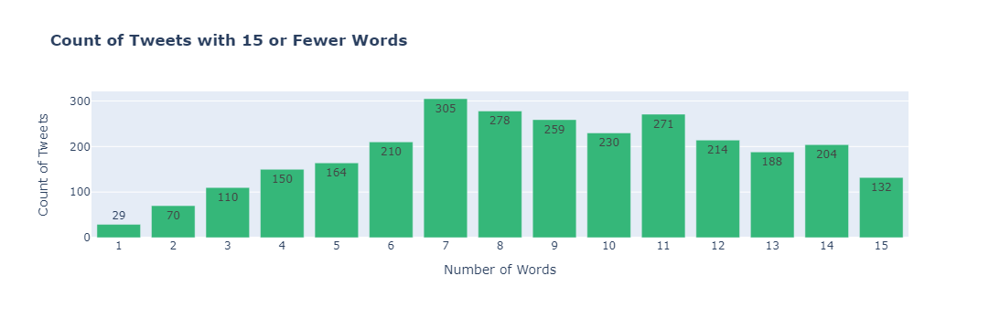

In [15]:
import plotly.graph_objects as go
# Plotting a bar plot to get count of tweets having words less than eqaul to 15
def plot_word_counts(df):
    """
    Plotting a bar plot of the count of tweets with 15 or fewer words.
    """
    # Filtering tweets with 15 or fewer words
    df_filtered = df[(df['words_count'] >= 1) & (df['words_count'] <= 15)]

    # Counting the number of such tweets per word count
    word_counts = df_filtered.groupby('words_count').size().reset_index(name='Count')

    # Creating the bar plot 
    fig = go.Figure(data=go.Bar(
        x=word_counts['words_count'],
        y=word_counts['Count'],
        marker_color=px.colors.sequential.Viridis[6],
        text=word_counts['Count'],
        textposition='auto'
    ))

    # Update layout 
    fig.update_layout(
        title='<b>Count of Tweets with 15 or Fewer Words</b>',
        xaxis_title='Number of Words',
        yaxis_title='Count of Tweets',
        xaxis=dict(
            tickmode='linear'
        ),
        yaxis=dict(
            title='Count of Tweets'
        ),
        autosize=True,
        margin=dict(l=100, r=100, b=100, t=100)
    )

    # Showing the plot
    fig.show()

# Plotting the bar plot
plot_word_counts(tweets_data)

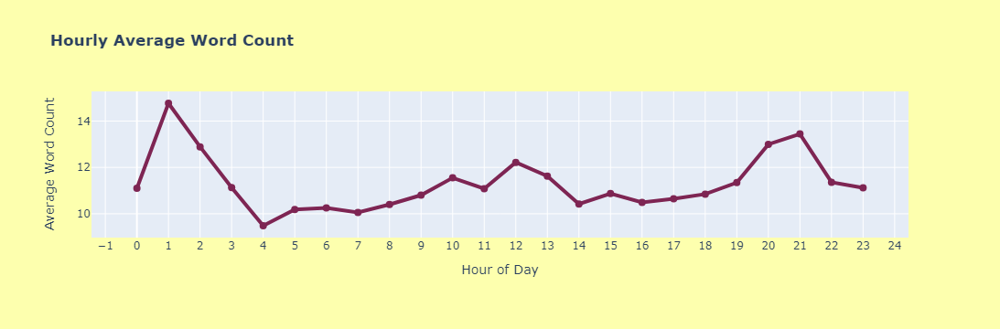

In [255]:
# Plotting a line plot to understand the averge word counts by each hour
# Calculating hourly average word count
hourly_word_count = tweets_data.groupby('hour')['words_count'].mean().reset_index(name='Average_Word_Count')

# Creating the line plot 
fig = px.line(
    hourly_word_count,
    x='hour',
    y='Average_Word_Count',
    markers=True,
    labels={'hour': 'Hour of Day', 'Average_Word_Count': 'Average Word Count'},
    title='<b>Hourly Average Word Count</b>',
    line_shape='linear'  # Ensuring the line is straight
)

# Update layout and trace
fig.update_layout(
    autosize=True,
    margin=dict(l=100, r=100, b=100, t=100),
    xaxis_title='Hour of Day',
    yaxis_title='Average Word Count',
    xaxis=dict(
        tickmode='linear',
        tickvals=list(range(0,23))  # hour ranges from 0 to 23
    ),
    yaxis=dict(
        title='Average Word Count'
    ),
    showlegend=False,  
    paper_bgcolor='#FDFFAE' 
)

fig.update_traces(
    line=dict(width=4, color='#7E2553'),  # Adjusting the line width and color here
    marker=dict(size=8, color='#7E2553')  # Adjusting the marker size and color here
)

# Showing the plot
fig.show()

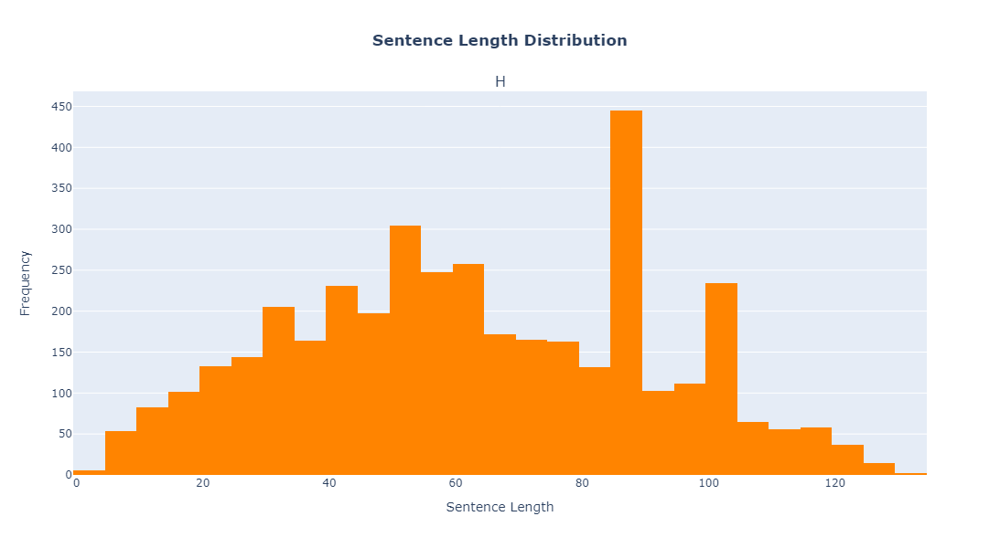

In [251]:
# Plotting a histogram plot to understand the distribution of Sentence length of tweets

fig_size = (12, 6)  # size as needed

# Creating subplot
fig = make_subplots(
    rows=1, cols=1,
    subplot_titles=('Histogram of Sentence Length Distribution')
)

# Plotting histogram of sentence length distribution
histogram = go.Histogram(
    x=tweets_data['sentence_length'],
    nbinsx=30,  # Number of bins
    marker_color='#FF8400',
    name='<b>Sentence Length Distribution</b>'
)
fig.add_trace(histogram, row=1, col=1)

# Update layout 
fig.update_layout(
    autosize=True,
    width=fig_size[0] * 100,  
    height=fig_size[1] * 100,  
    title_text='<b>Sentence Length Distribution</b>',
    title_x=0.5,
    showlegend=False
)

# Updating x and y axis labels
fig.update_xaxes(title_text='Sentence Length', row=1, col=1)
fig.update_yaxes(title_text='Frequency', row=1, col=1)

# Showing the plot
fig.show()


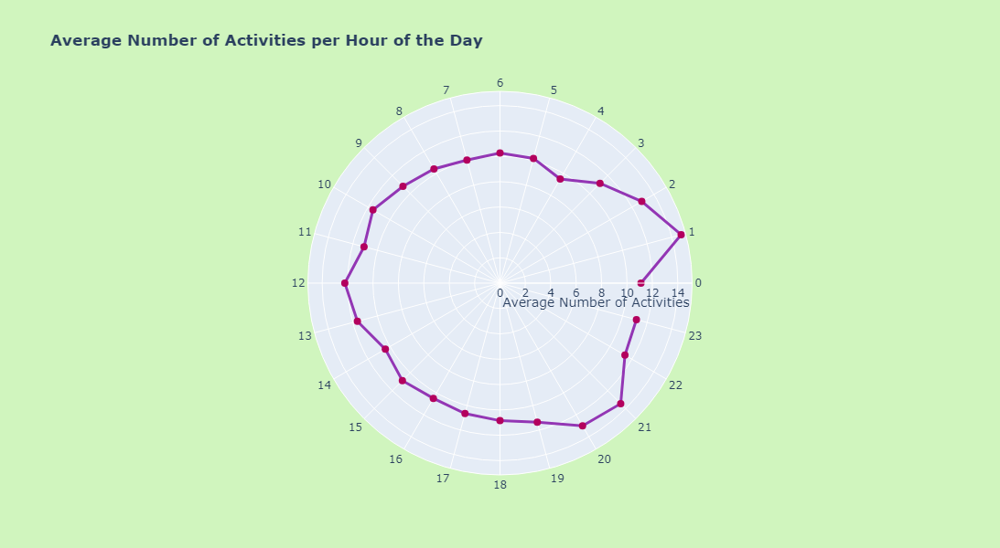

In [243]:
# Plotting a scatter polar plot to understand the average activities through tweets per hour of day
# Computing the average number of activities per hour
hourly_activity = tweets_data.groupby('hour')['words_count'].mean().reset_index(name='Average_Words_Count')

# Preparing data for polar plot
theta = hourly_activity['hour'].astype(str)  
r = hourly_activity['Average_Words_Count']

# Creating polar plot
fig = go.Figure()

fig.add_trace(go.Scatterpolar(
    r=r,
    theta=theta,
    mode='lines+markers',
    line=dict(color='#9336B4', width=3),  
    marker=dict(size=8, color='#B3005E')  
))

# Update layout 
fig.update_layout(
    polar=dict(
        radialaxis=dict(
            visible=True,
            title='Average Number of Activities'
        ),
        angularaxis=dict(
            visible=True,
            tickvals=theta,  # Ensuring all hour labels are shown
            ticktext=theta   
        )
    ),
    title='<b>Average Number of Activities per Hour of the Day</b>',
    showlegend=False,
    width=800,  
    height=600,  
    paper_bgcolor='#D0F5BE'  # Background color
)

# Showing the plot
fig.show()


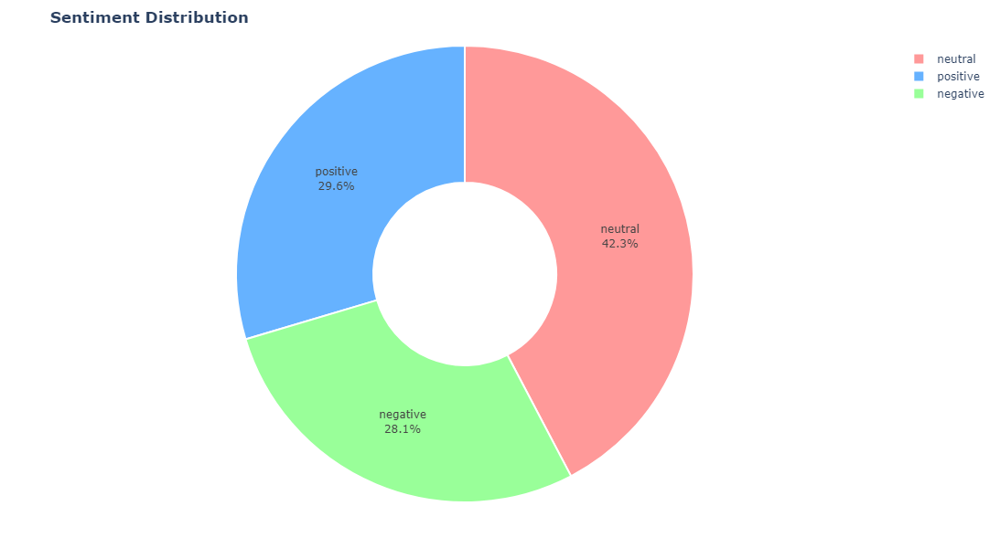

In [244]:
# plotting a donut plot to visualise the distribution of Sentiments

sentiment_counts = tweets_data['overall_sentiment'].value_counts().reset_index()
sentiment_counts.columns = ['Sentiment', 'Count']

# Creating donut plot
fig = go.Figure()

fig.add_trace(go.Pie(
    labels=sentiment_counts['Sentiment'],
    values=sentiment_counts['Count'],
    hole=0.4,  
    textinfo='label+percent',  
    marker=dict(line=dict(color='white', width=2))  
))

# Updating layout for better readability 
fig.update_layout(
    title='<b>Sentiment Distribution</b>',
    showlegend=True,
    width=800, 
    height=600,  
    margin=dict(l=50, r=50, t=50, b=50)  
    
)

fig.update_traces(
    marker=dict(colors=['#FF9999', '#66B2FF', '#99FF99', '#FFCC99'])  
    
)

# Showing the plot
fig.show()


In [245]:
# Creating the WordCloud to visualize the words in Postive, Negative and Neutral sentiments
from wordcloud import WordCloud
from PIL import Image
import nltk
from nltk.corpus import stopwords
import random

# Ensuring the stopwords list is downloaded
nltk.download('stopwords')

def flatten_list(l):
    return [x for y in l for x in y]

def plot_word_cloud(doc, color_func, background_color):
    # Generate the word cloud
    wordcloud = WordCloud(
        max_font_size=50, 
        max_words=100, 
        background_color=background_color,  
        contour_color='white',  
        contour_width=1  
    ).generate(" ".join(doc))
    
    # Converting word cloud to array
    wordcloud_array = np.array(wordcloud)
    
    # Creating Plotly figure
    fig = go.Figure()
    
    fig.add_trace(go.Image(z=wordcloud_array))

    # Updating layout
    fig.update_layout(
        title_text='<b>Word Cloud</b>',
        title_x=0.5,
        xaxis_visible=False,
        yaxis_visible=False,
        margin=dict(l=0, r=0, t=30, b=0)  
    )
    
    fig.show()

def generate_word_clouds(doc, sentiment, background_color):
    color_funcs = {
        "negative": red_color_func,
        "neutral": yellow_color_func,
        "positive": green_color_func
    }
    
    color_func = color_funcs.get(sentiment, None)
    if color_func:
        plot_word_cloud(doc, color_func, background_color)


sentiment_sorted = tweets_data.sort_values('hour', ascending=False)
positive_top_100 = sentiment_sorted[sentiment_sorted['overall_sentiment'] == "positive"].iloc[:100]
negative_top_100 = sentiment_sorted[sentiment_sorted['overall_sentiment'] == "negative"].iloc[:100]
neutral_top_100 = sentiment_sorted[sentiment_sorted['overall_sentiment'] == "neutral"].iloc[:100]

cleanup = lambda x: [y for y in x.split() if y not in stopwords.words('english')]
neg_doc = flatten_list(negative_top_100['text'].apply(cleanup))
pos_doc = flatten_list(positive_top_100['text'].apply(cleanup))
neu_doc = flatten_list(neutral_top_100['text'].apply(cleanup))

[nltk_data] Downloading package stopwords to /usr/share/nltk_data...

[nltk_data]   Package stopwords is already up-to-date!


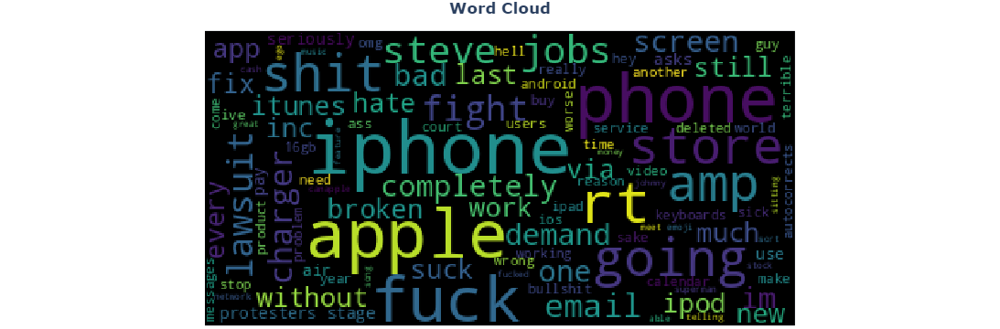

In [246]:
# Calling function to generate word clouds for negative sentiments
generate_word_clouds(neg_doc, 'negative', 'black')

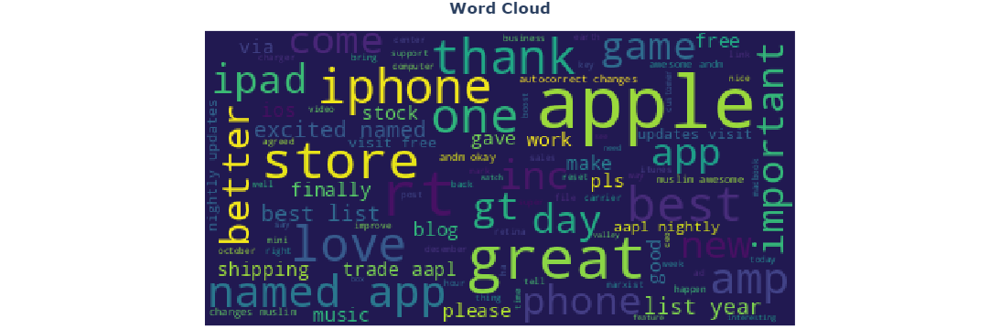

In [247]:
# Calling function to generate word clouds for positive sentiments
generate_word_clouds(pos_doc, 'positive', '#211951')  

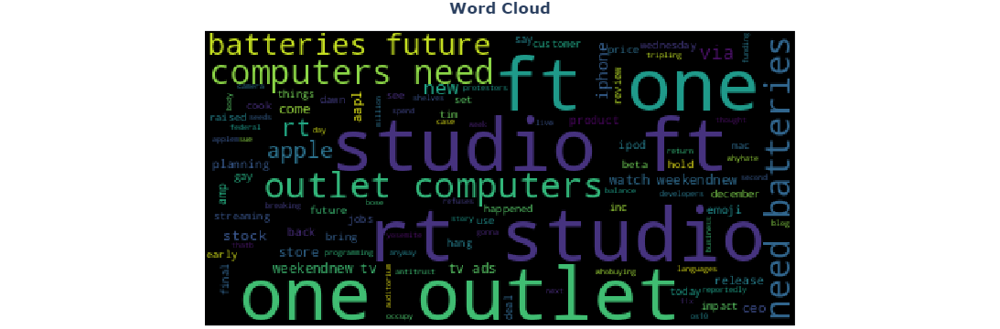

In [248]:
# Calling function to generate word clouds for Neutral sentiments
generate_word_clouds(neu_doc, 'neutral', 'black')  

# Tweets and Stock Price Relationship Analysis

In [257]:
# Counting occurrences of sentiments per day
sentiment_counts = tweets_data.groupby(['year', 'month', 'day', 'overall_sentiment']).size().unstack(fill_value=0)

# Determining overall sentiment for each day
sentiment_counts['overall_sentiment'] = sentiment_counts.apply(
    lambda row: 'positive' if row['positive'] > row['negative'] else 'negative', axis=1
)

# Resetting index to get the day column back as a regular column
result_df = sentiment_counts.reset_index()
var = [8, 9]

# Creating a mapping dictionary where each day maps to its sentiment
sentiment_mapping = result_df.set_index('day')['overall_sentiment'].to_dict()

swap_dict = {var[0]: sentiment_mapping[var[1]],
             var[1]: sentiment_mapping[var[1]]}

result_df['overall_sentiment'] = result_df['day'].map(lambda d: swap_dict.get(d, result_df.loc[result_df['day'] == d, 'overall_sentiment'].values[0]))

# Printing the resulted dataframe
result_df=result_df[['day', 'overall_sentiment']]
print(result_df[['day', 'overall_sentiment']])

overall_sentiment  day overall_sentiment

0                    1          positive

1                    2          negative

2                    3          positive

3                    4          positive

4                    5          positive

5                    6          negative

6                    7          negative

7                    8          negative

8                    9          negative

9                   10          positive


In [258]:
# Now we have extracted the overall sentiment from the tweet based on each day, Need the stock market data for same date range (2014-12-01 to 2014-12-10)
# reading the stock market data csv file
ts_data = pd.read_csv('/kaggle/input/apple-time-series/AAPL.csv')
ts_data.head()            # visualizing the first five rows of stock market data

,Date,Open,High,Low,Close,Adj Close,Volume
0,1980-12-12,0.128348,0.128906,0.128348,0.128348,0.099058,469033600
1,1980-12-15,0.122210,0.122210,0.121652,0.121652,0.093890,175884800
2,1980-12-16,0.113281,0.113281,0.112723,0.112723,0.086999,105728000
3,1980-12-17,0.115513,0.116071,0.115513,0.115513,0.089152,86441600
4,1980-12-18,0.118862,0.119420,0.118862,0.118862,0.091737,73449600


In [259]:
# Changing the date column into datetime format
ts_data['Date'] = pd.to_datetime(ts_data['Date'])
# Sorting data by 'Date'
ts_data = ts_data.sort_values(by='Date')

In [260]:
# Defining the start and end dates for the filtering of stock data
start_date = '2014-12-01'
end_date = '2014-12-10'

# Filtering the DataFrame for the date range
filtered_df = ts_data[(ts_data['Date'] >= start_date) & (ts_data['Date'] <= end_date)]

# Extracting year, month, and day
filtered_df['Year'] = filtered_df['Date'].dt.year
filtered_df['Month'] = filtered_df['Date'].dt.month
filtered_df['day'] = filtered_df['Date'].dt.day

# Resetting index 
filtered_df = filtered_df.reset_index(drop=True)
# Extracting day and Open column from stock data
filtered_df = filtered_df[['day','Open']]

In [261]:
# Since we have both tweets and stock processed data, we can merge both dataframes
merged_df = pd.merge(result_df, filtered_df, on='day', how='inner')
# Printing the merged DataFrame
merged_df.head(10)

,day,overall_sentiment,Open
0,1,positive,29.702499
1,2,negative,28.375000
2,3,positive,28.937500
3,4,positive,28.942499
4,5,positive,28.997499
5,8,negative,28.525000
6,9,negative,27.547501
7,10,positive,28.602501


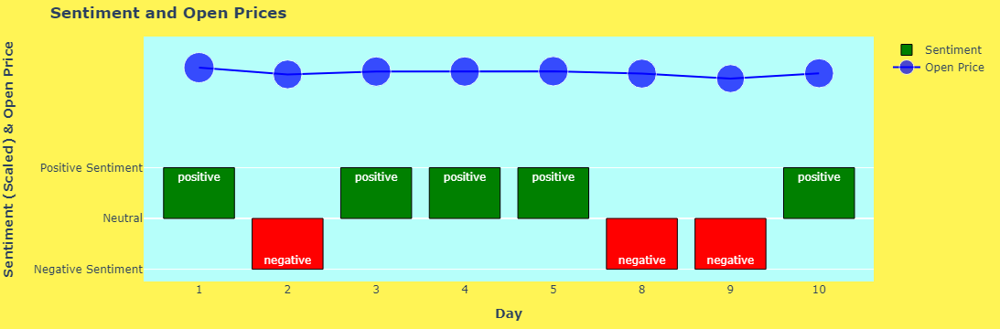

In [262]:
# Encoding sentiments as numerical values
sentiment_mapping = {'negative': -1, 'positive': 1}
merged_df['sentiment_encoded'] = merged_df['overall_sentiment'].map(sentiment_mapping)

# Creating the figure
fig = go.Figure()

# Adding bar plot for sentiments
fig.add_trace(go.Bar(
    x=merged_df['day'].astype(str),  
    y=merged_df['sentiment_encoded'] * 10,  
    marker_color=merged_df['overall_sentiment'].map({'negative': 'red', 'positive': 'green'}),
    name='Sentiment',
    text=merged_df['overall_sentiment'],
    textposition='inside',
    marker=dict(
        line=dict(
            color='black',  
            width=1 
        )
    )
))

# Add line bubble plot for Open prices
fig.add_trace(go.Scatter(
    x=merged_df['day'].astype(str),  
    y=merged_df['Open'],
    mode='markers+lines',  
    name='Open Price',
    line=dict(color='blue', width=2),  
    marker=dict(
        size=merged_df['Open'] / 0.9,  
        color='blue',  
        symbol='circle',  
        opacity=0.7  
    ),
    text=merged_df['Open'].apply(lambda x: f'{x:.2f}'),  
    textposition='top center',  
    textfont=dict(size=12, color='black') 
))

# Customize layout
fig.update_layout(
    title='<b>Sentiment and Open Prices</b>',
    xaxis_title='<b>Day</b>',
    yaxis_title='<b>Value</b>',
    xaxis=dict(
        tickvals=merged_df['day'].astype(str),  
        ticktext=[str(day) for day in merged_df['day']],  
        tickmode='array',  
        type='category'  
    ),
    yaxis=dict(
        tickvals=[-10, 0, 10],  
        ticktext=['Negative Sentiment', 'Neutral', 'Positive Sentiment'],
        title='<b>Sentiment (Scaled) & Open Price</b>'
    ),
    margin=dict(l=40, r=40, t=40, b=40),
    showlegend=True,
    plot_bgcolor='#B6FFFA',  
    paper_bgcolor='#FFF455'  
)

# Add hover data
fig.update_traces(
    selector=dict(mode='markers+lines')
)

# Showing the plot
fig.show()